SVI guide. Run trace. Collect zs. Plot zs against thickness, intensity.

for do(i = 300) what are the values in the output image. Obvs cannot be more than 256.

In [1]:
!pip install -q altair
!git clone -q https://github.com/RajatRasal/icl_dl_cw2_utils

fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.


In [2]:
ROOT_PATH = '../../../../'
MNIST_DATA_PATH = ROOT_PATH + 'assets/data/morphomnist_reversed_pgm/'
BASE_LOG_PATH = ROOT_PATH + 'assets/models/morphomnist_reversed_pgm/'

import sys
import os

sys.path.append(ROOT_PATH)

import pyro
import torch
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import pandas as pd
import inspect
from collections import OrderedDict
from functools import partial

from deepscm.datasets.morphomnist.create_synth_intensity_causes_thickness_data import model as true_model
from deepscm.experiments import morphomnist_reversed_arrows
from deepscm.experiments.morphomnist_reversed_arrows.base_experiment import EXPERIMENT_REGISTRY, MODEL_REGISTRY
from deepscm.datasets.morphomnist import MorphoMNISTLike
from icl_dl_cw2_utils.utils.plotting import plot_tsne

torch.autograd.set_grad_enabled(False)

In [3]:
%matplotlib inline

## Setup and Data Inspection

In [4]:
def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)), interpolation='nearest')
    
def prep_single_image(batch):
    x = batch['image']
    thickness = batch['thickness'].unsqueeze(0).unsqueeze(0).float()
    intensity = batch['intensity'].unsqueeze(0).unsqueeze(0).float()

    x = x.float()
    x = x.unsqueeze(0).unsqueeze(0)

    return {'x': x, 'thickness': thickness, 'intensity': intensity}

def prep_batch(batch):
    x = batch['image']
    thickness = batch['thickness'].unsqueeze(1).float()
    intensity = batch['intensity'].unsqueeze(1).float()
    x = x.float().unsqueeze(1)
    return {'x': x, 'thickness': thickness, 'intensity': intensity}


class LayerActivations:
    
    def __init__(self, name):
        self.activation = {}
        self.name = name
        
    def __call__(self, model, _input, output):
        self.activation[self.name] = output.detach()
        
    def get_activation(self):
        return self.activation

In [5]:
test_data = MorphoMNISTLike(MNIST_DATA_PATH, train=False, columns=['thickness', 'intensity'])

../../../../deepscm/datasets/morphomnist/__init__.py:80: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  self.images = torch.as_tensor(images)


In [6]:
exp = 'ConditionalReversedVISEM'

In [7]:
checkpoint_path = f'{BASE_LOG_PATH}/{exp}/version_0/'

base_path = os.path.join(checkpoint_path, 'checkpoints')
checkpoint_path = os.path.join(base_path, os.listdir(base_path)[0])

checkpoint_path = f'{BASE_LOG_PATH}/{exp}/version_0/'

base_path = os.path.join(checkpoint_path, 'checkpoints')
checkpoint_path = os.path.join(base_path, os.listdir(base_path)[0])

ckpt = torch.load(checkpoint_path, map_location=torch.device('cpu'))
hparams = ckpt['hyper_parameters']

model_class = MODEL_REGISTRY[hparams['model']]

model_params = {
    k: v for k, v in hparams.items() if (k in inspect.signature(model_class.__init__).parameters
                                         or k in k in inspect.signature(model_class.__bases__[0].__init__).parameters
                                         or k in k in inspect.signature(model_class.__bases__[0].__bases__[0].__init__).parameters)
}

new_state_dict = OrderedDict()

for key, value in ckpt['state_dict'].items():
    new_key = key.replace('pyro_model.', '')
    new_state_dict[new_key] = value

loaded_model = model_class(**model_params)
loaded_model.load_state_dict(new_state_dict)

for p in loaded_model._buffers.keys():
    if 'norm' in p:
        setattr(loaded_model, p, getattr(loaded_model, p))

loaded_model.eval()

def sample_pgm(num_samples, model):
    with pyro.plate('observations', num_samples):
        return model.pgm_model()

model = partial(sample_pgm, model=loaded_model)

In [8]:
test_points = 10000
test_dataset = test_data[:test_points]
_test_data = prep_batch(test_dataset)

labels = test_dataset['label']
x, thickness, intensity = _test_data['x'], _test_data['thickness'], _test_data['intensity']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([7, 2, 1, 0, 4, 1, 4, 9, 5, 9], dtype=torch.uint8)
tensor([0, 6, 9, 0, 1, 5, 9, 7, 3, 4], dtype=torch.uint8)
tensor([9, 6, 6, 5, 4, 0, 7, 4, 0, 1], dtype=torch.uint8)
tensor([3, 1, 3, 4, 7, 2, 7, 1, 2, 1], dtype=torch.uint8)
tensor([1, 7, 4, 2, 3, 5, 1, 2, 4, 4], dtype=torch.uint8)
tensor([6, 3, 5, 5, 6, 0, 4, 1, 9, 5], dtype=torch.uint8)
tensor([7, 8, 9, 3, 7, 4, 6, 4, 3, 0], dtype=torch.uint8)
tensor([7, 0, 2, 9, 1, 7, 3, 2, 9, 7], dtype=torch.uint8)
tensor([7, 6, 2, 7, 8, 4, 7, 3, 6, 1], dtype=torch.uint8)
tensor([3, 6, 9, 3, 1, 4, 1, 7, 6, 9], dtype=torch.uint8)


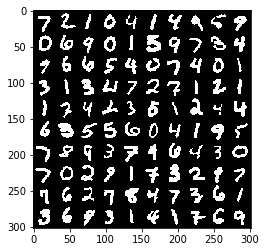

In [9]:
for i in range(10, 101, 10):
    print(labels[i-10:i])

show(torchvision.utils.make_grid(x[:100], nrow=10))

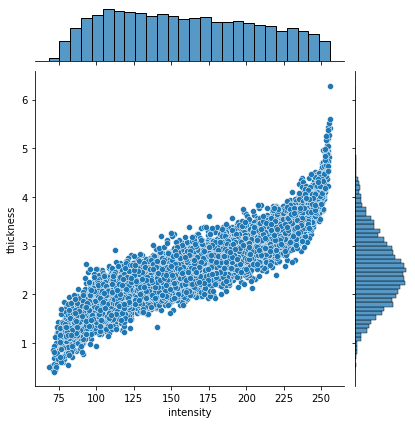

In [10]:
pgm_df = pd.DataFrame(
    torch.cat([intensity, thickness], dim=1).numpy(),
    columns=['intensity', 'thickness']
)
sns.jointplot(data=pgm_df, x='intensity', y='thickness')
plt.show()

## Using Hooks to get mean of latent encoder

In [11]:
loaded_model.latent_encoder

DeepIndepNormal(
  (backbone): Sequential(
    (0): Linear(in_features=102, out_features=100, bias=True)
    (1): ReLU()
  )
  (mean_head): Linear(in_features=100, out_features=16, bias=True)
  (logvar_head): Linear(in_features=100, out_features=16, bias=True)
)

In [12]:
get_activations_mean_head = LayerActivations('mean_head')
loaded_model.latent_encoder.mean_head.register_forward_hook(get_activations_mean_head)

loaded_model.guide(x, thickness, intensity)
get_activations_mean_head.get_activation()

{'mean_head': tensor([[ 0.2727,  0.0370,  0.1486,  ...,  1.8023, -0.3266, -0.5648],
         [ 0.5403, -0.6693,  0.1913,  ..., -1.3034,  0.7789, -1.1528],
         [ 0.9794, -0.6922,  0.5285,  ..., -0.6450, -0.3913, -0.0076],
         ...,
         [ 0.5451, -0.3914, -0.2771,  ..., -0.3334, -1.1076, -0.0250],
         [ 0.2375,  0.0026, -1.7005,  ..., -1.2048, -0.1712,  0.6266],
         [-0.7331,  1.0717, -0.6901,  ..., -0.7650,  0.3105,  0.2252]])}

## TSNE Exploration

In [13]:
from sklearn.manifold import TSNE

thickness_rounded = np.rint(np.array(thickness))
intensity_rounded = np.round(np.array(intensity, dtype=int), -1)

In [14]:
latent_encoder_activations = get_activations_mean_head.get_activation()['mean_head']

In [15]:
latent_projs = np.load('tsne_latent_projections.npy', allow_pickle=True)[()]

# latent_projs = {}

tsne_no = 6
perplexity_lb = 5
perplexity_ub = 100
intervals = int((perplexity_ub - perplexity_lb) / tsne_no)
iter_range = range(perplexity_lb, perplexity_ub, intervals)

# for i, perplexity in enumerate(iter_range):
#     print(f'perplexity: {perplexity}')
#     tsne = TSNE(n_components=2, random_state=0, perplexity=perplexity,
#                 init='pca', verbose=1, n_jobs=-1, early_exaggeration=2)
#     latent_proj = tsne.fit_transform(latent_encoder_activations)
#     latent_projs[perplexity] = latent_proj
#     print()
    
# np.save('tsne_latent_projections.npy', latent_projs)

TSNE Key:
- thickness of each TSNE datapoint = thickness in original dataset
- color of each TSNE datapoint = intensity in original dataset (blue 

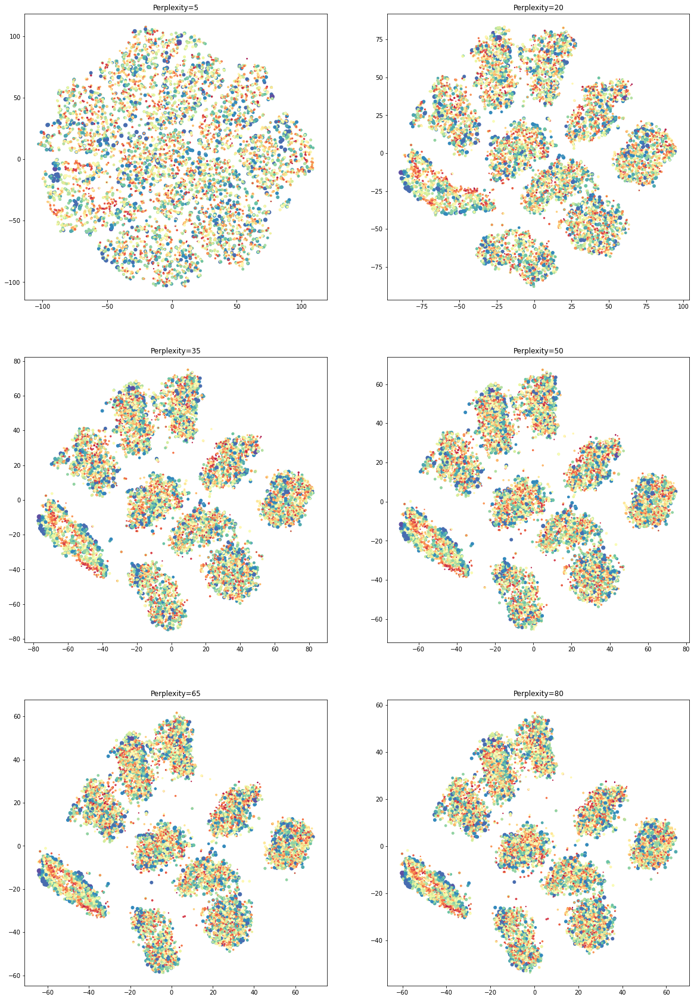

In [16]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 30))

color = intensity_rounded.flatten() / intensity_rounded.max()
size = thickness_rounded.flatten() / thickness_rounded.max()

for ax, perplexity in zip(axes.flatten(), iter_range):
    ax.scatter(latent_projs[perplexity][:, 0],
               latent_projs[perplexity][:, 1],
               c=color, cmap="Spectral", s=6*(size*3)**2)
    ax.set_title(f'Perplexity={perplexity}')

plt.show()

### TSNE Perplexity = 20

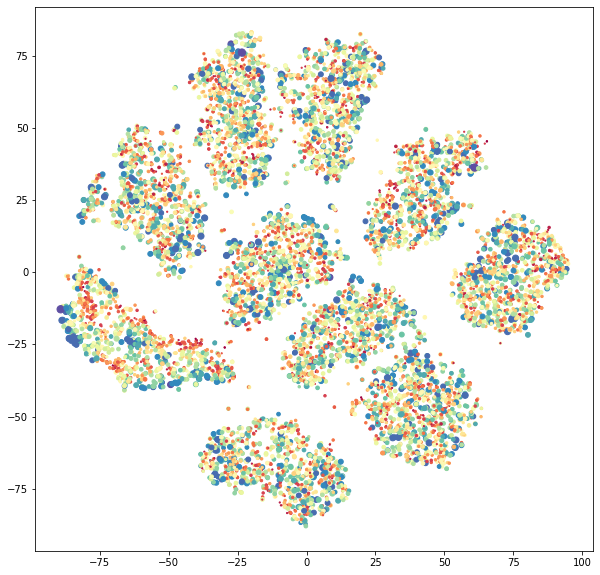

In [17]:
plt.figure(figsize=(10, 10))

color = intensity_rounded.flatten() / intensity_rounded.max()
size = thickness_rounded.flatten() / thickness_rounded.max()
perplexity = 20

plt.scatter(latent_projs[perplexity][:, 0],
            latent_projs[perplexity][:, 1],
            c=color, cmap="Spectral", s=6*(size*3)**2)

plt.show()

In [18]:
### Interactive TSNE Perplexity = 20

In [19]:
from icl_dl_cw2_utils.utils.plotting import plot_tsne
from torch.utils.data import DataLoader, TensorDataset

dataset = TensorDataset(test_dataset['image'].reshape(test_points, 1, 28, 28, 1)[:1000], test_dataset['label'][:1000])
dataloader = DataLoader(dataset, test_points, shuffle=False)

plot_tsne(latent_projs[perplexity][:1000], dataloader, 1000, darkmode=False)

alt.HConcatChart(...)

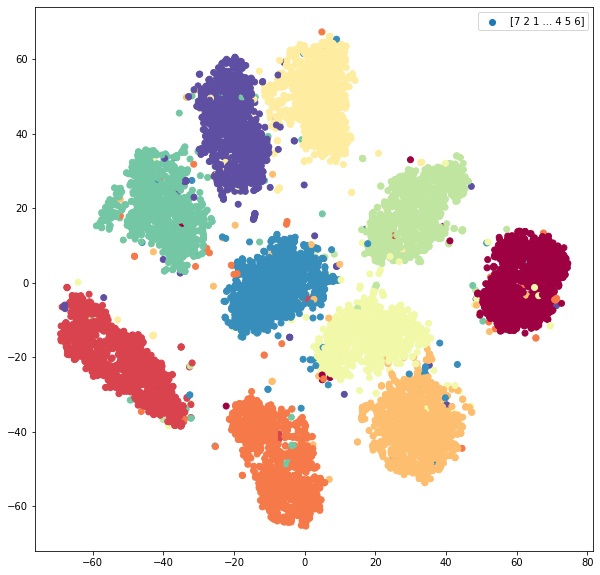

In [20]:
plt.figure(figsize=(10, 10))
perplexity = 50
plt.scatter(latent_projs[perplexity][:, 0],
            latent_projs[perplexity][:, 1],
            c=np.round(labels/10, 1), cmap="Spectral",
            label=np.array(labels))

plt.legend()
plt.show()

## PCA Exploration

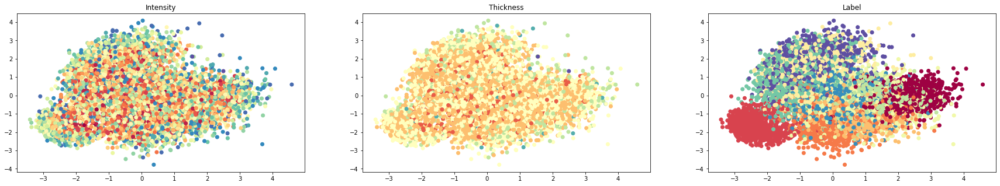

In [21]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2, random_state=0)
latent_proj = pca.fit_transform(latent_encoder_activations)

color_intensity = intensity_rounded.flatten() / intensity_rounded.max()
color_thickness = thickness_rounded.flatten() / thickness_rounded.max()
color_label = labels.flatten() / labels.max()

# PCA color for intensity/thickness/class - do 3 plots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 5))

axes[0].set_title('Intensity')
axes[0].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_intensity, cmap="Spectral")

axes[1].set_title('Thickness')
axes[1].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_thickness, cmap="Spectral")

axes[2].set_title('Label')
axes[2].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_label, cmap="Spectral")

plt.show()

In [22]:
# 3D PCA

# pca = PCA(n_components=3, random_state=0)
# latent_proj = pca.fit_transform(latent_encoder_activations)

# color_intensity = intensity_rounded.flatten() / intensity_rounded.max()
# color_intensity = thickness_rounded.flatten() / thickness_rounded.max()
# color_label = labels.flatten() / labels.max()

# # PCA color for intensity/thickness/class - do 3 plots
# fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 5))
# axes[0].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_intensity, cmap="Spectral")
# axes[1].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_intensity, cmap="Spectral")
# axes[2].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_label, cmap="Spectral")

# plt.show()

## Comparing Counterfactual Latent Space

In [23]:
intervention = {'thickness': torch.tensor([5.]).repeat(test_points).reshape(-1, 1)}
cfs = loaded_model.counterfactual(_test_data, intervention, 10)

/vol/bitbucket/rrr2417/deepscm/ENV2/lib/python3.8/site-packages/pyro/primitives.py:360: UserWarning: logvar_head.weight was not registered in the param store because requires_grad=False
  warnings.warn("{} was not registered in the param store because".format(param_name) +
/vol/bitbucket/rrr2417/deepscm/ENV2/lib/python3.8/site-packages/pyro/primitives.py:360: UserWarning: logvar_head.bias was not registered in the param store because requires_grad=False
  warnings.warn("{} was not registered in the param store because".format(param_name) +


In [24]:
del cfs['z']
loaded_model.guide(**cfs)
cf_latent_encoder_activations = get_activations_mean_head.get_activation()['mean_head']

### TSNE for Counterfactuals

In [25]:
all_activations = torch.cat([latent_encoder_activations, cf_latent_encoder_activations], dim=0)

perplexity = 20
tsne = TSNE(n_components=2, random_state=0, perplexity=perplexity,
            init='pca', verbose=1, n_jobs=-1, early_exaggeration=2)
all_latent_proj = tsne.fit_transform(all_activations)

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 20000 samples in 0.000s...
[t-SNE] Computed neighbors for 20000 samples in 7.199s...
[t-SNE] Computed conditional probabilities for sample 1000 / 20000
[t-SNE] Computed conditional probabilities for sample 2000 / 20000
[t-SNE] Computed conditional probabilities for sample 3000 / 20000
[t-SNE] Computed conditional probabilities for sample 4000 / 20000
[t-SNE] Computed conditional probabilities for sample 5000 / 20000
[t-SNE] Computed conditional probabilities for sample 6000 / 20000
[t-SNE] Computed conditional probabilities for sample 7000 / 20000
[t-SNE] Computed conditional probabilities for sample 8000 / 20000
[t-SNE] Computed conditional probabilities for sample 9000 / 20000
[t-SNE] Computed conditional probabilities for sample 10000 / 20000
[t-SNE] Computed conditional probabilities for sample 11000 / 20000
[t-SNE] Computed conditional probabilities for sample 12000 / 20000
[t-SNE] Computed conditional probabilities for sam

#### True TSNE

In [26]:
dataset = TensorDataset(test_dataset['image'].reshape(test_points, 1, 28, 28, 1)[:1000], test_dataset['label'][:1000])
dataloader = DataLoader(dataset, test_points, shuffle=False)

plot_tsne(all_latent_proj[:10000][:1000], dataloader, 1000, darkmode=False)

alt.HConcatChart(...)

#### Counterfactual Latent Space TSNE

In [27]:
cf_dataset = TensorDataset(cfs['x'].reshape(test_points, 1, 28, 28, 1)[:1000], test_dataset['label'][:1000])
cf_dataloader = DataLoader(cf_dataset, test_points, shuffle=False)

plot_tsne(all_latent_proj[10000:20000][:1000], cf_dataloader, 1000, darkmode=False)

alt.HConcatChart(...)

### PCA for Counterfactuals

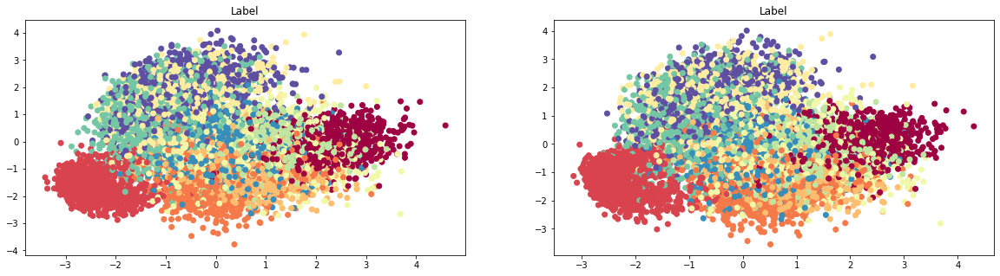

In [28]:
cf_latent_proj = pca.transform(cf_latent_encoder_activations)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 5))

axes[0].set_title('Label')
axes[0].scatter(latent_proj[:, 0], latent_proj[:, 1], c=color_label, cmap="Spectral")

axes[1].set_title('Label')
axes[1].scatter(cf_latent_proj[:, 0], cf_latent_proj[:, 1], c=color_label, cmap="Spectral")

plt.show()